# Battle of the Amsterdam Neighborhoods

### Mama Mia Pizza from Rome, Italy, wants to conquer the Europe's capital cities starting with Amsterdam in the Netherlands

#### The final report can be found on my Github repository: https://github.com/WiljoM/Coursera_Capstone/blob/master/Battle%20of%20the%20Amsterdam%20Neigborhoods%20Part%201.pdf

#### Disclaimer:  Mama Mia Pizza is a fictional name only used for the Coursera Capstone Project as part of the IBM Data Science Certification

Sources
Areas of Amsterdam, Netherlands (geojson file):
https://maps.amsterdam.nl/open_geodata/?k=204

Airbnb data Amsterdam:
http://data.insideairbnb.com/the-netherlands/north-holland/amsterdam/2019-12-07/visualisations/listings.csv

## 1. Import libraries

In [1]:
# import modules

import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt

# import k-means from clustering stage
from sklearn.cluster import KMeans

from sklearn.metrics import silhouette_score

print('Libraries imported.')



Libraries imported.


In [2]:
# convert an address into latitude and longitude values
%pip install geopy 
from geopy.geocoders import Nominatim

Note: you may need to restart the kernel to use updated packages.


In [3]:
# map rendering library
%pip install folium==0.5.0 
import folium

Note: you may need to restart the kernel to use updated packages.


## 2. Load the dataset and explore the data

In [4]:
# Load the Airbnb dataset
airbnb_data=pd.read_csv('listings.csv')
print('Data downloaded!')

Data downloaded!


In [5]:
# Shape of the dataset, 20000+ records, it's too large !
airbnb_data.shape

(20025, 16)

In [6]:
# First 5 rows of the dataset
airbnb_data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2818,Quiet Garden View Room & Super Fast WiFi,3159,Daniel,NaN,Oostelijk Havengebied - Indische Buurt,52.36575,4.94142,Private room,59,3,277,2019-11-21,2.13,1,0
1,20168,Studio with private bathroom in the centre 1,59484,Alexander,NaN,Centrum-Oost,52.36509,4.89354,Private room,80,1,306,2019-12-05,2.57,2,198
2,25428,Lovely apt in City Centre (w.lift) near Jordaan,56142,Joan,NaN,Centrum-West,52.37297,4.88339,Entire home/apt,125,14,3,2019-05-11,0.13,2,71
3,27886,"Romantic, stylish B&B houseboat in canal district",97647,Flip,NaN,Centrum-West,52.38673,4.89208,Private room,155,2,206,2019-11-11,2.14,1,251
4,28871,Comfortable double room,124245,Edwin,NaN,Centrum-West,52.36719,4.89092,Private room,75,2,318,2019-11-23,2.81,3,134


In [7]:
# Check for empty cells
airbnb_data.isnull().sum()

id                                    0
name                                 34
host_id                               0
host_name                           158
neighbourhood_group               20025
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                        2404
reviews_per_month                  2404
calculated_host_listings_count        0
availability_365                      0
dtype: int64

#### Drop 2404 rows where never has been a review, assuming these are no active Airbnb hosts

In [8]:
# Drop rows
airbnb_data.dropna(subset=["last_review"], axis=0, inplace=True)

# reset index, because we dropped rows
airbnb_data.reset_index(drop=True, inplace=True)

In [9]:
# 17621 airbnb hosts left
airbnb_data.shape

(17621, 16)

#### Dataset is still too large and needs to be decreased

In [10]:
# What about the distribution of 'price' ?

# np.histogram returns 2 values
count, bin_edges = np.histogram(airbnb_data['price'])

print(count) # frequency count
print(bin_edges) # bin ranges, default = 10 bins

[17565    48     1     1     0     2     0     0     1     3]
[   0.  900. 1800. 2700. 3600. 4500. 5400. 6300. 7200. 8100. 9000.]


In [11]:
# 17000+ records left, so let's remove al the outliers above 400 euro per night
indexNames = airbnb_data[airbnb_data['price'] > 400 ].index
airbnb_data.drop(indexNames , inplace=True)
airbnb_data.shape

(17253, 16)

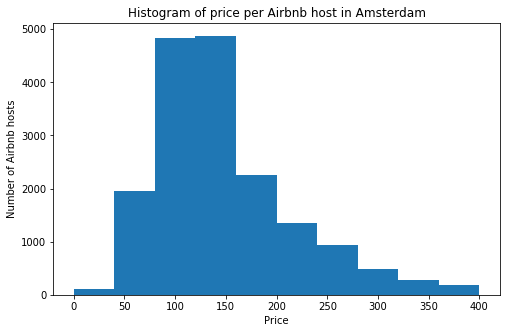

In [12]:
# Plot the price distribution in a histogram.
airbnb_data['price'].plot(kind='hist', figsize=(8, 5))

plt.title('Histogram of price per Airbnb host in Amsterdam') # add a title to the histogram
plt.ylabel('Number of Airbnb hosts') # add y-label
plt.xlabel('Price') # add x-label

plt.show()

#### Let's focus on the Airbnb hosts between 100 and 150 euro per night to decrease the dataset to a workable level of aprox. 7000 records

In [13]:
indexNames = airbnb_data[airbnb_data['price'] <100].index
airbnb_data.drop(indexNames , inplace=True)
indexNames = airbnb_data[airbnb_data['price'] >150].index
airbnb_data.drop(indexNames , inplace=True)
airbnb_data.shape

(6960, 16)

## 3. Display the Airbnb hosts on the Amsterdam Map

#### What are the Amsterdam Latitude and Longitude?

In [17]:
address = 'Amsterdam, NL'

geolocator = Nominatim(user_agent="Jupyter")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Amsterdam are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Amsterdam are 52.3745403, 4.89797550561798.


#### Load the Areas of Amsterdam (in Dutch: Gebieden)

In [14]:
# Load the Areas of Amsterdam
df_areas=pd.read_csv('GEBIEDEN22.csv', delimiter=';')
print('Data downloaded!')
df_areas

Data downloaded!


,OBJECTNUMMER,Gebied_code,Gebied,Stadsdeel_code,Opp_m2,WKT_LNG_LAT,WKT_LAT_LNG,LNG,LAT,Unnamed: 9
0,1,Dxxx,Westpoort,B,28991600,"POLYGON((4.885861 52.39937,4.882702 52.401695,...","POLYGON((52.39937 4.885861,52.401695 4.882702,...",4.807319,52.411465,NaN
1,2,DX21,Bijlmer-Oost,T,4076020,"POLYGON((4.996899 52.317636,4.996784 52.317753...","POLYGON((52.317636 4.996899,52.317753 4.996784...",4.976832,52.319564,NaN
2,3,DX06,"Geuzenveld, Slotermeer, Sloterdijken",F,15357200,"POLYGON((4.844813 52.385134,4.844798 52.385138...","POLYGON((52.385134 4.844813,52.385138 4.844798...",4.801156,52.379990,NaN
3,4,DX07,Osdorp,F,9174720,"POLYGON((4.820437 52.351738,4.818066 52.356167...","POLYGON((52.351738 4.820437,52.356167 4.818066...",4.787646,52.363814,NaN
4,5,DX08,"De Aker, Sloten, Nieuw-Sloten",F,7584560,"POLYGON((4.84714 52.336896,4.847032 52.337685,...","POLYGON((52.336896 4.84714,52.337685 4.847032,...",4.807275,52.342135,NaN
5,6,DX09,Slotervaart,F,5899060,"POLYGON((4.850498 52.364232,4.850459 52.365189...","POLYGON((52.364232 4.850498,52.365189 4.850459...",4.831346,52.355328,NaN
6,7,DX04,Bos en Lommer,E,3448010,"POLYGON((4.864963 52.388959,4.864757 52.388964...","POLYGON((52.388959 4.864963,52.388964 4.864757...",4.850156,52.383843,NaN
7,8,DX17,Noord-West,N,8347620,"POLYGON((4.930721 52.411601,4.930411 52.411936...","POLYGON((52.411601 4.930721,52.411936 4.930411...",4.893224,52.414954,NaN
8,9,DX03,Westerpark,E,3854760,"POLYGON((4.895084 52.388684,4.894675 52.389933...","POLYGON((52.388684 4.895084,52.389933 4.894675...",4.875999,52.385466,NaN
9,10,DX05,"Oud West, De Baarsjes",E,3327090,"POLYGON((4.882097 52.362049,4.881886 52.362155...","POLYGON((52.362049 4.882097,52.362155 4.881886...",4.862335,52.365897,NaN


#### Display a map of the Amsterdam Areas together with the Airbnb hosts

In [51]:
# Define geo file
amsterdam_geo = r'areas22.geojson'

# create map of Amsterdam using latitude and longitude values
airbnb_map = folium.Map(location=[latitude, longitude], zoom_start=12)

# generate choropleth map to display the Amsterdam Areas
airbnb_map.choropleth(
    geo_data=amsterdam_geo,
    key_on='feature.properties.Gebied',
    fill_color='YlOrRd', 
    fill_opacity=0.25, 
    line_opacity=1.0,
    line_color='blue',
    )

# add markers to map
for LAT, LNG, Gebied in zip(df_areas['LAT'], df_areas['LNG'], df_areas['Gebied']):
    area= 'Amsterdam Neigborhood: {}'.format(Gebied)
    folium.Marker(
    location=[LAT, LNG],
    popup=area,
    icon=folium.Icon(color='gray', icon='home')).add_to(airbnb_map)


for lat, lng, neighborhood, price in zip(airbnb_data['latitude'], airbnb_data['longitude'], airbnb_data['neighbourhood'],airbnb_data['price']):
    label = '{}, {} Euro'.format(neighborhood, price)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=0.1,
        popup=label,
        color='yellow',
        fill=True,
        fill_color='yellow',
        fill_opacity=1.0,
        parse_html=False).add_to(airbnb_map) 

airbnb_map

The yellow dots represent the Airbnb hosts, and the 'house' markers represent the Amsterdam Neigborhoods or Areas (Gebieden in Dutch)

--> In case the map does not display on Github, please refer to the PDF report:
https://github.com/WiljoM/Coursera_Capstone/blob/master/Battle%20of%20the%20Amsterdam%20Neigborhoods%20Part%201.pdf
or render this notebook on nbviewer.jupyter.org: https://nbviewer.jupyter.org/github/WiljoM/Coursera_Capstone/blob/master/Battle%20of%20the%20Amsterdam%20Neigborhoods.ipynb

## 4. Lets get the 'Nearby Venues' data from Foursquare

#### Define Foursquare Credentials and Version

In [20]:
CLIENT_ID = 'Your Client ID' # your Foursquare ID
CLIENT_SECRET = 'Your Secret Key' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: P0IY52FI4JBLPVPPZN5L1NKE44HOHWERNZ1CCUYF4BNUT0YM
CLIENT_SECRET:XFTQ4MU5DYJI5PTWK1XEPSYNQB5QVJZ5EGXP2Q4I3UE2HWL4


#### Make a function to extract venues data for each neighborhoods in Amsterdam

In [21]:
def getNearbyVenues(names, latitudes, longitudes, radius=2000, LIMIT=250):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['neighborhood', 
                  'neighborhood_latitude', 
                  'neighborhood_longitude', 
                  'venue', 
                  'venue_latitude', 
                  'venue_longitude', 
                  'venue_category']
    
    return(nearby_venues)

#### Write the code to run the above function on each neighborhood and create a new dataframe called amsterdam_venues

In [22]:
amsterdam_venues = getNearbyVenues(names=df_areas['Gebied'],
                                   latitudes=df_areas['LAT'],
                                   longitudes=df_areas['LNG']
                                  )

Westpoort
Bijlmer-Oost
Geuzenveld, Slotermeer, Sloterdijken
Osdorp
De Aker, Sloten, Nieuw-Sloten
Slotervaart
Bos en Lommer
Noord-West
Westerpark
Oud West, De Baarsjes
Oud-Zuid
Buitenveldert, Zuidas
Centrum-West
Centrum-Oost
Oud-Noord
Noord-Oost
IJburg, Zeeburgereiland
Indische Buurt, Oostelijk Havengebied
Oud-Oost
De Pijp, Rivierenbuurt
Watergraafsmeer
Bijlmer-Centrum, Amstel III
Gaasperdam, Driemond


In [24]:
# How many venues were returned?
print('{} venues were returned by Foursquare.'.format(amsterdam_venues.shape[0]))
amsterdam_venues.head()

1889 venues were returned by Foursquare.


,neighborhood,neighborhood_latitude,neighborhood_longitude,venue,venue_latitude,venue_longitude,venue_category
0,Westpoort,52.411465,4.807319,Het HEM,52.420664,4.829541,Museum
1,Westpoort,52.411465,4.807319,Bij Marjan,52.399681,4.795596,Breakfast Spot
2,Westpoort,52.411465,4.807319,North Sea Venue,52.422247,4.819607,Nightclub
3,Westpoort,52.411465,4.807319,Flinders Design,52.422425,4.830142,Furniture / Home Store
4,Westpoort,52.411465,4.807319,KFC,52.427470,4.820170,Fast Food Restaurant


#### Let's check the totals per venue category

In [25]:
amsterdam_venues.groupby('venue_category')['venue'].count().sort_values(ascending=False)

venue_category
Hotel                              114
Restaurant                          97
Coffee Shop                         74
Café                                74
Bar                                 55
Supermarket                         50
Italian Restaurant                  47
Park                                44
Bakery                              40
French Restaurant                   32
Breakfast Spot                      31
Pizza Place                         29
Turkish Restaurant                  29
Gym / Fitness Center                27
Snack Place                         23
Gym                                 22
Ice Cream Shop                      21
Chinese Restaurant                  20
Yoga Studio                         20
Deli / Bodega                       19
Soccer Field                        19
Sandwich Place                      18
Grocery Store                       18
Brewery                             17
Indonesian Restaurant               17
Cocktail B

####  Check how many venues were returned for each neighborhood

In [26]:
amsterdam_venues.groupby('neighborhood').count()

,neighborhood_latitude,neighborhood_longitude,venue,venue_latitude,venue_longitude,venue_category
neighborhood,,,,,,
"Bijlmer-Centrum, Amstel III",99,99,99,99,99,99
Bijlmer-Oost,76,76,76,76,76,76
Bos en Lommer,100,100,100,100,100,100
"Buitenveldert, Zuidas",100,100,100,100,100,100
Centrum-Oost,100,100,100,100,100,100
Centrum-West,100,100,100,100,100,100
"De Aker, Sloten, Nieuw-Sloten",100,100,100,100,100,100
"De Pijp, Rivierenbuurt",100,100,100,100,100,100
"Gaasperdam, Driemond",28,28,28,28,28,28


#### Find out how many unique categories can be curated from all the returned venues

In [27]:
print('There are {} uniques categories.'.format(len(amsterdam_venues['venue_category'].unique())))

There are 241 uniques categories.


## 5. Display only the Restaurants on our map

#### Create an array of all restaurants

In [28]:
array = []
search = 'Restaurant'
for i in amsterdam_venues.venue_category :
    if search in i:
        array.append(i)

# and add Pizza place because this is also a restaurant
array.append('Pizza Place')

#### Create a new dataset of all restaurants in Amsterdam

In [29]:
amsterdam_restaurants = amsterdam_venues.loc[amsterdam_venues['venue_category'].isin(array)]
amsterdam_restaurants.head()

,neighborhood,neighborhood_latitude,neighborhood_longitude,venue,venue_latitude,venue_longitude,venue_category
4,Westpoort,52.411465,4.807319,KFC,52.427470,4.820170,Fast Food Restaurant
8,Westpoort,52.411465,4.807319,McDonald's,52.427396,4.820760,Fast Food Restaurant
19,Bijlmer-Oost,52.319564,4.976832,De Smeltkroes,52.322755,4.974752,South American Restaurant
22,Bijlmer-Oost,52.319564,4.976832,Pasta di Mamma,52.314779,4.955087,Italian Restaurant
24,Bijlmer-Oost,52.319564,4.976832,Margherita Tutta La Vita!,52.329054,4.955773,Pizza Place


### Display the Restaurants on our map

In [30]:
# create map of Amsterdam using latitude and longitude values
airbnb_map = folium.Map(location=[latitude, longitude], zoom_start=12)

# generate choropleth map to display the Amsterdam Areas
airbnb_map.choropleth(
    geo_data=amsterdam_geo,
    key_on='feature.properties.Gebied',
    fill_color='YlOrRd', 
    fill_opacity=0.25, 
    line_opacity=1.0,
    line_color='blue',
    )

# Plot the Airbnb hosts on the map
for lat, lng, neighbourhood, price in zip(airbnb_data['latitude'], airbnb_data['longitude'], airbnb_data['neighbourhood'],airbnb_data['price']):
    label = '{}, {} Euro'.format(neighbourhood, price)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=0.1,
        popup=label,
        color='yellow',
        fill=True,
        fill_color='yellow',
        fill_opacity=1.0,
        parse_html=False).add_to(airbnb_map) 

# Plot the Amsterdam Restaurants on the map
for lat, lng, neighbourhood, venue in zip(amsterdam_restaurants['venue_latitude'], amsterdam_restaurants['venue_longitude'], amsterdam_restaurants['neighborhood'],amsterdam_restaurants['venue']):
    label = '{}, {}'.format(venue, neighbourhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='blue',
        fill=True,
        fill_color='red',
        fill_opacity=0.5,
        parse_html=True).add_to(airbnb_map) 

airbnb_map

Notice that Amsterdam Area 'Noord-Oost' doesn't display any restaurant. The two markers displaying in this area are marked as 'IJburg, Zeeburger Eiland' and 'Oud Noord' according to Fourtsquare.

--> In case the map does not display on Github, please refer to the PDF report:
https://github.com/WiljoM/Coursera_Capstone/blob/master/Battle%20of%20the%20Amsterdam%20Neigborhoods%20Part%201.pdf
or render this notebook on nbviewer.jupyter.org: https://nbviewer.jupyter.org/github/WiljoM/Coursera_Capstone/blob/master/Battle%20of%20the%20Amsterdam%20Neigborhoods.ipynb

## 6. Analyze each neighborhood

In [31]:
# one hot encoding
amsterdam_onehot = pd.get_dummies(amsterdam_restaurants[['venue_category']], prefix="", prefix_sep="")

#column lists before adding neighborhood
column_names = ['neighborhood'] + list(amsterdam_onehot.columns)

# add neighborhood column back to dataframe
amsterdam_onehot['neighborhood'] = amsterdam_restaurants['neighborhood'] 

# move neighborhood column to the first column
amsterdam_onehot = amsterdam_onehot[column_names]

amsterdam_onehot.head()

,neighborhood,American Restaurant,Argentinian Restaurant,Asian Restaurant,Australian Restaurant,Belgian Restaurant,Caribbean Restaurant,Chinese Restaurant,Comfort Food Restaurant,Doner Restaurant,Dutch Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,French Restaurant,Greek Restaurant,Indian Restaurant,Indonesian Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Lebanese Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,Moroccan Restaurant,North Indian Restaurant,Pizza Place,Portuguese Restaurant,Ramen Restaurant,Restaurant,Satay Restaurant,Scandinavian Restaurant,Seafood Restaurant,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Sushi Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant
4,Westpoort,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,Westpoort,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19,Bijlmer-Oost,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
22,Bijlmer-Oost,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
24,Bijlmer-Oost,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


#### Grouped by neighborhood

In [32]:
amsterdam_restaurant_grouped = amsterdam_onehot.groupby('neighborhood').sum().reset_index()
amsterdam_restaurant_grouped

,neighborhood,American Restaurant,Argentinian Restaurant,Asian Restaurant,Australian Restaurant,Belgian Restaurant,Caribbean Restaurant,Chinese Restaurant,Comfort Food Restaurant,Doner Restaurant,Dutch Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,French Restaurant,Greek Restaurant,Indian Restaurant,Indonesian Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Lebanese Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,Moroccan Restaurant,North Indian Restaurant,Pizza Place,Portuguese Restaurant,Ramen Restaurant,Restaurant,Satay Restaurant,Scandinavian Restaurant,Seafood Restaurant,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Sushi Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant
0,"Bijlmer-Centrum, Amstel III",0,0,1,0,0,0,4,0,0,0,0,0,1,1,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,1,0,0,4,0,1,0,0,0,0,1,0,0,0,0,0
1,Bijlmer-Oost,1,0,0,0,0,0,4,0,0,0,0,0,1,2,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,1,0,0,3,1,0,1,2,0,0,0,0,0,2,0,0
2,Bos en Lommer,0,0,0,0,0,2,0,0,0,0,0,0,1,1,0,0,0,1,2,0,0,0,0,1,1,1,0,0,0,2,0,1,7,0,1,2,0,0,0,0,0,1,3,1,0
3,"Buitenveldert, Zuidas",0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,1,2,0,0,0,0,0,0,0,0,0,0,0,0,11,0,0,1,1,0,0,0,0,1,0,1,0
4,Centrum-Oost,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,1,1,0,3,0,0,0,1,0,0,0,1,0,0,0,0,0,5,0,0,1,0,0,0,0,0,2,0,0,0
5,Centrum-West,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,1,0,4,0,0,1,1,0,0,0,0,0,0,1,0,0,3,0,0,1,0,0,0,0,1,1,0,0,0
6,"De Aker, Sloten, Nieuw-Sloten",0,0,1,0,0,0,2,0,0,0,0,0,0,1,0,0,0,2,0,0,0,0,0,1,0,1,0,0,0,4,0,0,3,0,0,0,0,0,0,1,0,1,4,0,0
7,"De Pijp, Rivierenbuurt",0,1,0,1,0,0,0,0,1,0,0,0,0,0,3,0,1,2,6,5,0,0,0,1,0,2,1,0,0,5,1,1,4,0,0,2,1,0,0,0,1,1,0,1,1
8,"Gaasperdam, Driemond",0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0
9,"Geuzenveld, Slotermeer, Sloterdijken",0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,5,0,0


### Cluster Neighborhoods and Examine Clusters

#### What is the optimal k using the Silhoutte Score?

Let's determine the optimal value of K for our dataset using the Silhouette Coefficient Method

From sklearn documentation - https://scikit-learn.org/stable/modules/clustering.html

A higher Silhouette Coefficient score relates to a model with better-defined clusters.

In [33]:
amsterdam_grouped_clustering = amsterdam_restaurant_grouped.drop('neighborhood', 1)

for n_cluster in range(2, 10):
    kmeans = KMeans(n_clusters=n_cluster).fit(amsterdam_grouped_clustering)
    label = kmeans.labels_
    sil_coeff = silhouette_score(amsterdam_grouped_clustering, label, metric='euclidean')
    print("For n_clusters={}, The Silhouette Coefficient is {}".format(n_cluster, sil_coeff))

For n_clusters=2, The Silhouette Coefficient is 0.22844391429425503
For n_clusters=3, The Silhouette Coefficient is 0.25396818256927134
For n_clusters=4, The Silhouette Coefficient is 0.24056222210026956
For n_clusters=5, The Silhouette Coefficient is 0.21517349726221882
For n_clusters=6, The Silhouette Coefficient is 0.21888426417376594
For n_clusters=7, The Silhouette Coefficient is 0.1956549358008158
For n_clusters=8, The Silhouette Coefficient is 0.20301791030757166
For n_clusters=9, The Silhouette Coefficient is 0.19429071778259674


As we can see, n_clusters=3 has highest Silhouette Coefficient. This means that 2 should be the optimal number of clusters. For n_clusters=3, The Silhouette Coefficient is 0.25396818256927134

#### Run k-means to cluster the neighborhoods into 3 clusters.

In [34]:
# set number of clusters
kclusters = 3

amsterdam_grouped_clustering = amsterdam_restaurant_grouped.drop('neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(amsterdam_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_

array([0, 0, 2, 2, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 2, 1, 1, 2, 1, 1, 0],
      dtype=int32)

In [35]:
amsterdam_results = pd.DataFrame(kmeans.cluster_centers_)
amsterdam_results.columns = amsterdam_grouped_clustering.columns
amsterdam_results.index = ['cluster0','cluster1','cluster2']
amsterdam_results['Total Sum'] = amsterdam_results.sum(axis = 1)
amsterdam_results

,American Restaurant,Argentinian Restaurant,Asian Restaurant,Australian Restaurant,Belgian Restaurant,Caribbean Restaurant,Chinese Restaurant,Comfort Food Restaurant,Doner Restaurant,Dutch Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,French Restaurant,Greek Restaurant,Indian Restaurant,Indonesian Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Lebanese Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,Moroccan Restaurant,North Indian Restaurant,Pizza Place,Portuguese Restaurant,Ramen Restaurant,Restaurant,Satay Restaurant,Scandinavian Restaurant,Seafood Restaurant,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Sushi Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Total Sum
cluster0,0.100,-6.938894e-18,0.30,-5.551115e-17,-1.387779e-17,0.200,1.500,2.775558e-17,-6.938894e-18,0.500,-6.938894e-18,0.20,3.000000e-01,1.000,-2.220446e-16,0.200,5.551115e-17,0.60,1.00,5.551115e-17,1.000000e-01,0.10,-1.387779e-17,0.400,0.100,0.200,-5.551115e-17,1.000000e-01,-1.387779e-17,1.300,-6.938894e-18,-1.387779e-17,2.1,1.000000e-01,0.20,0.200,0.200,-6.938894e-18,1.000000e-01,0.300,2.775558e-17,0.200,2.000,0.100,-6.938894e-18,13.70
cluster1,0.125,1.250000e-01,0.25,7.500000e-01,1.250000e-01,0.375,0.125,5.000000e-01,1.250000e-01,0.375,1.250000e-01,0.25,-2.775558e-17,0.125,3.750000e+00,0.125,6.250000e-01,0.75,3.75,7.500000e-01,-6.938894e-18,0.25,2.500000e-01,0.125,0.125,0.375,7.500000e-01,-1.387779e-17,2.500000e-01,1.375,1.250000e-01,1.250000e-01,4.5,-6.938894e-18,0.00,0.875,0.125,-6.938894e-18,-6.938894e-18,0.125,5.000000e-01,1.125,0.375,1.125,1.250000e-01,25.75
cluster2,0.000,0.000000e+00,0.25,2.500000e-01,2.500000e-01,0.500,1.000,2.500000e-01,0.000000e+00,0.000,0.000000e+00,0.25,2.500000e-01,0.250,5.000000e-01,0.000,2.500000e-01,1.25,1.75,7.500000e-01,0.000000e+00,0.00,0.000000e+00,0.250,0.500,0.250,2.500000e-01,2.500000e-01,0.000000e+00,1.250,0.000000e+00,2.500000e-01,10.0,0.000000e+00,0.25,0.750,0.250,2.500000e-01,0.000000e+00,0.000,2.500000e-01,1.250,1.500,0.500,0.000000e+00,25.75


The Total and Total Sum of cluster0 has smallest value. It shows that the market representing cluster0 is less saturated. The markets of cluster1 and cluster 2 are highly saturated and therefor not suitable for starting a new restaurant.

#### Create a new dataframe with Neighborhood, Cluster# and Total Sum

In [36]:
amsterdam_restaurant_grouped['Total'] = amsterdam_restaurant_grouped.sum(axis=1)

In [37]:
amsterdam_results_merged = pd.DataFrame(amsterdam_restaurant_grouped['neighborhood'])
amsterdam_results_merged['Total'] = amsterdam_restaurant_grouped['Total']
amsterdam_results_merged = amsterdam_results_merged.assign(Cluster_Labels = kmeans.labels_)

In [38]:
print(amsterdam_results_merged.shape)
amsterdam_results_merged

(22, 3)


,neighborhood,Total,Cluster_Labels
0,"Bijlmer-Centrum, Amstel III",16,0
1,Bijlmer-Oost,20,0
2,Bos en Lommer,28,2
3,"Buitenveldert, Zuidas",21,2
4,Centrum-Oost,19,1
5,Centrum-West,19,1
6,"De Aker, Sloten, Nieuw-Sloten",21,0
7,"De Pijp, Rivierenbuurt",42,1
8,"Gaasperdam, Driemond",5,0
9,"Geuzenveld, Slotermeer, Sloterdijken",8,0


#### Merge amsterdam_results_merged with df_areas, but first remove the 'Noord-Oost' area because no restaurants were found

In [39]:
# Remove Noord-Oost area
df_areas.drop(df_areas.loc[df_areas['Gebied']=='Noord-Oost'].index, inplace=True)

In [40]:
# Merge two dataframes
amsterdam_merged = df_areas

amsterdam_merged = amsterdam_merged.join(amsterdam_results_merged.set_index('neighborhood'), on='Gebied')

print(amsterdam_merged.shape)
amsterdam_merged

(22, 12)


,OBJECTNUMMER,Gebied_code,Gebied,Stadsdeel_code,Opp_m2,WKT_LNG_LAT,WKT_LAT_LNG,LNG,LAT,Unnamed: 9,Total,Cluster_Labels
0,1,Dxxx,Westpoort,B,28991600,"POLYGON((4.885861 52.39937,4.882702 52.401695,...","POLYGON((52.39937 4.885861,52.401695 4.882702,...",4.807319,52.411465,NaN,2,0
1,2,DX21,Bijlmer-Oost,T,4076020,"POLYGON((4.996899 52.317636,4.996784 52.317753...","POLYGON((52.317636 4.996899,52.317753 4.996784...",4.976832,52.319564,NaN,20,0
2,3,DX06,"Geuzenveld, Slotermeer, Sloterdijken",F,15357200,"POLYGON((4.844813 52.385134,4.844798 52.385138...","POLYGON((52.385134 4.844813,52.385138 4.844798...",4.801156,52.379990,NaN,8,0
3,4,DX07,Osdorp,F,9174720,"POLYGON((4.820437 52.351738,4.818066 52.356167...","POLYGON((52.351738 4.820437,52.356167 4.818066...",4.787646,52.363814,NaN,15,0
4,5,DX08,"De Aker, Sloten, Nieuw-Sloten",F,7584560,"POLYGON((4.84714 52.336896,4.847032 52.337685,...","POLYGON((52.336896 4.84714,52.337685 4.847032,...",4.807275,52.342135,NaN,21,0
5,6,DX09,Slotervaart,F,5899060,"POLYGON((4.850498 52.364232,4.850459 52.365189...","POLYGON((52.364232 4.850498,52.365189 4.850459...",4.831346,52.355328,NaN,30,2
6,7,DX04,Bos en Lommer,E,3448010,"POLYGON((4.864963 52.388959,4.864757 52.388964...","POLYGON((52.388959 4.864963,52.388964 4.864757...",4.850156,52.383843,NaN,28,2
7,8,DX17,Noord-West,N,8347620,"POLYGON((4.930721 52.411601,4.930411 52.411936...","POLYGON((52.411601 4.930721,52.411936 4.930411...",4.893224,52.414954,NaN,8,0
8,9,DX03,Westerpark,E,3854760,"POLYGON((4.895084 52.388684,4.894675 52.389933...","POLYGON((52.388684 4.895084,52.389933 4.894675...",4.875999,52.385466,NaN,19,1
9,10,DX05,"Oud West, De Baarsjes",E,3327090,"POLYGON((4.882097 52.362049,4.881886 52.362155...","POLYGON((52.362049 4.882097,52.362155 4.881886...",4.862335,52.365897,NaN,27,0


## 7. Plot the clusters on the Airbnb map

In [41]:
# create map of Amsterdam using latitude and longitude values
airbnb_map = folium.Map(location=[latitude, longitude], zoom_start=12)

# generate choropleth map to display the Amsterdam Areas
airbnb_map.choropleth(
    geo_data=amsterdam_geo,
    key_on='feature.properties.Gebied',
    fill_color='YlOrRd', 
    fill_opacity=0.25, 
    line_opacity=1.0,
    line_color='blue',
    )

# Add markers to map

# Plot the Airbnb hosts on the map
for lat, lng, neighbourhood, price in zip(airbnb_data['latitude'], airbnb_data['longitude'], airbnb_data['neighbourhood'],airbnb_data['price']):
    label = '{}, {} Euro'.format(neighbourhood, price)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=0.1,
        popup=label,
        color='yellow',
        fill=True,
        fill_color='yellow',
        fill_opacity=1.0,
        parse_html=False).add_to(airbnb_map) 

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add cluster markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(amsterdam_merged['LAT'], amsterdam_merged['LNG'], amsterdam_merged['Gebied'], amsterdam_merged['Cluster_Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=7,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(airbnb_map)

airbnb_map

Red markers: cluster0, Green markers: cluster1, Purple markers: cluster2

--> In case the map does not display on Github, please refer to the PDF report:
https://github.com/WiljoM/Coursera_Capstone/blob/master/Battle%20of%20the%20Amsterdam%20Neigborhoods%20Part%201.pdf
or render this notebook on nbviewer.jupyter.org: https://nbviewer.jupyter.org/github/WiljoM/Coursera_Capstone/blob/master/Battle%20of%20the%20Amsterdam%20Neigborhoods.ipynb

## 8. Focus on cluster0

#### Let's focus on cluster0 since we've seen above that this cluster is less saturated

In [42]:
amsterdam_merged[amsterdam_merged['Cluster_Labels'] == 0].reset_index(drop=True)

,OBJECTNUMMER,Gebied_code,Gebied,Stadsdeel_code,Opp_m2,WKT_LNG_LAT,WKT_LAT_LNG,LNG,LAT,Unnamed: 9,Total,Cluster_Labels
0,1,Dxxx,Westpoort,B,28991600,"POLYGON((4.885861 52.39937,4.882702 52.401695,...","POLYGON((52.39937 4.885861,52.401695 4.882702,...",4.807319,52.411465,NaN,2,0
1,2,DX21,Bijlmer-Oost,T,4076020,"POLYGON((4.996899 52.317636,4.996784 52.317753...","POLYGON((52.317636 4.996899,52.317753 4.996784...",4.976832,52.319564,NaN,20,0
2,3,DX06,"Geuzenveld, Slotermeer, Sloterdijken",F,15357200,"POLYGON((4.844813 52.385134,4.844798 52.385138...","POLYGON((52.385134 4.844813,52.385138 4.844798...",4.801156,52.379990,NaN,8,0
3,4,DX07,Osdorp,F,9174720,"POLYGON((4.820437 52.351738,4.818066 52.356167...","POLYGON((52.351738 4.820437,52.356167 4.818066...",4.787646,52.363814,NaN,15,0
4,5,DX08,"De Aker, Sloten, Nieuw-Sloten",F,7584560,"POLYGON((4.84714 52.336896,4.847032 52.337685,...","POLYGON((52.336896 4.84714,52.337685 4.847032,...",4.807275,52.342135,NaN,21,0
5,8,DX17,Noord-West,N,8347620,"POLYGON((4.930721 52.411601,4.930411 52.411936...","POLYGON((52.411601 4.930721,52.411936 4.930411...",4.893224,52.414954,NaN,8,0
6,10,DX05,"Oud West, De Baarsjes",E,3327090,"POLYGON((4.882097 52.362049,4.881886 52.362155...","POLYGON((52.362049 4.882097,52.362155 4.881886...",4.862335,52.365897,NaN,27,0
7,17,DX16,"IJburg, Zeeburgereiland",M,13787000,"POLYGON((5.039059 52.354569,5.038812 52.358098...","POLYGON((52.354569 5.039059,52.358098 5.038812...",4.997029,52.361586,NaN,15,0
8,22,DX20,"Bijlmer-Centrum, Amstel III",T,8431710,"POLYGON((4.971842 52.284355,4.970005 52.286362...","POLYGON((52.284355 4.971842,52.286362 4.970005...",4.950592,52.303143,NaN,16,0
9,23,DX22,"Gaasperdam, Driemond",T,9605980,"POLYGON((5.021546 52.302451,5.021464 52.303129...","POLYGON((52.302451 5.021546,52.303129 5.021464...",4.988479,52.304423,NaN,5,0


Now let's compare it with the number of Airbnb hosts per neighborhood in cluster0. Assuming the best place to start a Mama Mia Pizza restaurant is in the neighborhood with the most Airbnb hosts. First create a dataframe with only the neighborhoods from cluster0

In [43]:
# Make a copy of the airbnb_data for further processing
airbnb_cluster0=airbnb_data.copy()

In [44]:
# Drop all neighborhoods from cluster1 and cluster2
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Bos en Lommer'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Oud-Noord'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Slotervaart'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Oud-Zuid'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Westerpark'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Centrum-West'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Centrum-Oost'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Watergraafsmeer'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Buitenveldert - Zuidas'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Zuid'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='Oud-Oost'].index, inplace=True)
airbnb_cluster0.drop(airbnb_cluster0.loc[airbnb_cluster0['neighbourhood']=='De Pijp - Rivierenbuurt'].index, inplace=True)
# And display it's shape
airbnb_cluster0.shape

(2245, 16)

In [47]:
airbnb_grouped = airbnb_cluster0.groupby('neighbourhood').count().reset_index()

In [49]:
# And display the airbnb data in relation to cluster0, sorted with the highest value on top
airbnb_grouped.sort_values(by=['id'], ascending=False)

,neighbourhood,id,name,host_id,host_name,neighbourhood_group,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
3,De Baarsjes - Oud-West,1351,1350,1351,1344,0,1351,1351,1351,1351,1351,1351,1351,1351,1351,1351
9,Oostelijk Havengebied - Indische Buurt,369,369,369,362,0,369,369,369,369,369,369,369,369,369,369
6,IJburg - Zeeburgereiland,123,123,123,123,0,123,123,123,123,123,123,123,123,123,123
8,Noord-West,122,122,122,121,0,122,122,122,122,122,122,122,122,122,122
7,Noord-Oost,88,88,88,88,0,88,88,88,88,88,88,88,88,88,88
5,Geuzenveld - Slotermeer,59,59,59,59,0,59,59,59,59,59,59,59,59,59,59
2,De Aker - Nieuw Sloten,40,40,40,40,0,40,40,40,40,40,40,40,40,40,40
10,Osdorp,29,29,29,29,0,29,29,29,29,29,29,29,29,29,29
4,Gaasperdam - Driemond,28,28,28,27,0,28,28,28,28,28,28,28,28,28,28
1,Bijlmer-Oost,21,21,21,21,0,21,21,21,21,21,21,21,21,21,21


## 10. Conclusion
### The Amsterdam Area 'De Baarsjes - Oud-West' is probably the most effective neigborhood to start a Mama Mia Pizza restaurant that can make a profit of the many tourist visiting Amsterdam via an Airbnb host, because:
#### - This area is in cluster0, so the less occupied with restaurants compared to other neighbourhoods
#### - This area has the most active Airbnb hosts of all cluster0 areas: 1351